In [25]:
import requests
import json
import numpy as np
import datetime

import IPython.display as display
import cv2
import binascii
import struct
import matplotlib.pyplot as plt
%matplotlib inline

def pretty_print(obj):
    print(json.dumps(obj, indent=2))

In [26]:
X_API_KEY = open('apik.txt','r').readline()

In [27]:
cameras_response = requests.get("http://app.sigrow.com/api/v2/cameras", 
                                headers={"X-API-Key": X_API_KEY}).json()



In [28]:
pretty_print(cameras_response[0]['id'])

1019


In [29]:
selected_camera = cameras_response[0]['id']

In [30]:
selected_camera

1019

In [32]:
after = datetime.datetime.strptime("13/09/2021 00:00:01", "%d/%m/%Y %H:%M:%S")
before = datetime.datetime.strptime("10/10/2021 23:59:59", "%d/%m/%Y %H:%M:%S")

shots_response = requests.get("http://app.sigrow.com/api/v2/camera/{}/shots?after={}&before={}".format(
    selected_camera, after.strftime("%Y%m%dT%H%M%SZ"), before.strftime("%Y%m%dT%H%M%SZ")
), headers={
    "X-API-Key": X_API_KEY
}).json()


# pretty_print(shots_response)

In [33]:
shots_response['shots'][0]

{'date': {'in_centrals_timezone': '2021-09-13T03:00:22+03:00',
  'in_gmt_timezone': '2021-09-13T00:00:22+00:00'},
 'id': 1350644}

In [34]:
def get_rgb_source(item):
    return item["type"] == "RGB_JPG"

In [23]:
path='C://Users//Synergy Solutions//Desktop//sigrow//Jupyter Python API Thermal cams//cubil//'

In [43]:
now=int((datetime.datetime.now()- datetime.datetime(1970,1,1)).total_seconds())

In [44]:
now

1633873653

In [45]:
for num in range(0,len(shots_response['shots']),1):
    selected_shot=shots_response["shots"][num]
    shot_source_response = requests.get("http://app.sigrow.com/api/v2/camera/{}/shot/{}/source".format(
        selected_camera, selected_shot["id"]
    ), headers={
        "X-API-Key": X_API_KEY
    }).json()
    rgb_source = list(filter(get_rgb_source, shot_source_response["sources"]))[0]
    pic=requests.get(rgb_source["url"]).content
    now=int((datetime.datetime.now()- datetime.datetime(1970,1,1)).total_seconds())
    fname=path+str(now)+".jpg"
    with open(fname, 'wb') as out_file:
        out_file.write(pic)

In [15]:
import binascii
import struct

In [16]:
with open('out.jpg', 'wb') as out_file:
    out_file.write(pic)

In [17]:
def img():
    img=cv2.imread('out.jpg').astype(np.float32)/255
    img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    return img

In [18]:
def showimg(img):
    fig=plt.figure(figsize=(18,12))
    ax=fig.add_subplot(111)
    ax.imshow(img)

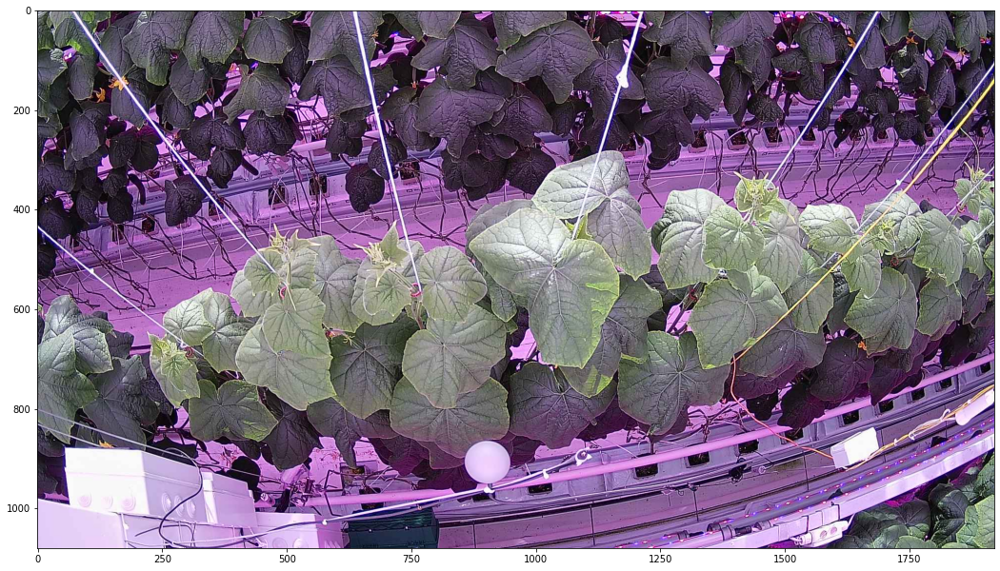

In [19]:
showimg(img())

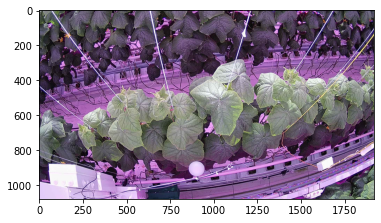

In [20]:
plt.imshow(img())

In [21]:
img=cv2.imread('out.jpg',1)
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

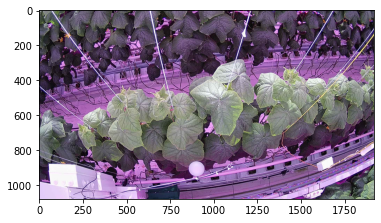

In [22]:
plt.imshow(img);

In [29]:
head=img[380:520, 458:580]

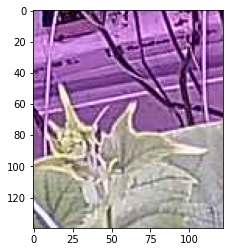

In [30]:
plt.imshow(head)


In [226]:
methods=['cv2.TM_CCOEFF', 'cv2.TM_CCOEFF_NORMED','cv2.TM_CCORR','cv2.TM_CCORR_NORMED', 'cv2.TM_SQDIFF','cv2.TM_SQDIFF_NORMED']

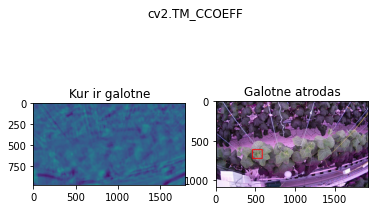

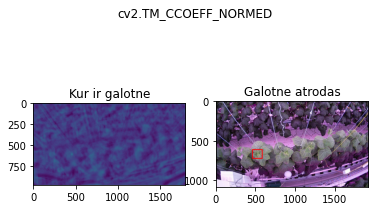

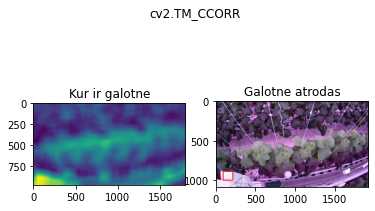

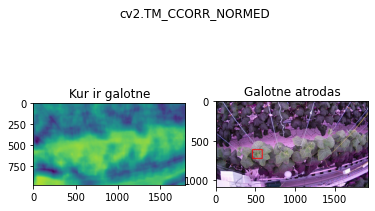

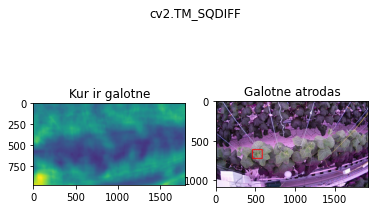

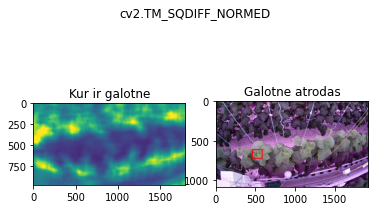

In [227]:
for m in methods:
    head_is=img.copy()
    method=eval(m)
    # Atrodam sakritíbu
    res=cv2.matchTemplate(head_is, head, method)
    
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
    
    if method in [cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED]:
        top_left=min_loc
        
    else:
        top_left=max_loc
    
    height, width, channels = head.shape
    
    bottom_right= (top_left[0]+width, top_left[1]+height)
    cv.rectangle(head_is,top_left, bottom_right, (255,0,0),10)
    
    plt.subplot(121)
    plt.imshow(res)
    plt.title('Kur ir galotne')
    
    plt.subplot(122)
    plt.imshow(head_is)
    plt.title('Galotne atrodas')
    plt.suptitle (m)
    
    plt.show()
    
    print('\n')
    print('\n')

In [228]:
head_is=img.copy()

In [229]:
leafcorn=cv2.cvtColor(head_is, cv2.COLOR_BGR2GRAY)

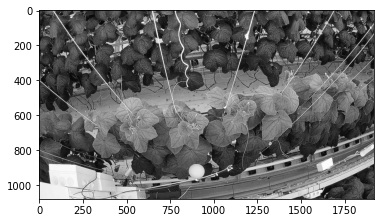

In [230]:
plt.imshow(leafcorn, cmap='gray')

In [231]:
gray=np.float32(leafcorn)

In [232]:
gray

array([[ 32.,  63.,  93., ...,  74.,  34., 110.],
       [ 48.,  82., 113., ...,  77.,  51., 135.],
       [ 97., 125., 144., ..., 103.,  54., 115.],
       ...,
       [236., 236., 236., ...,  37.,  32.,  35.],
       [236., 236., 236., ...,  50.,  50.,  55.],
       [236., 236., 236., ...,  51.,  48.,  51.]], dtype=float32)

In [233]:
dst=cv2.cornerHarris(src=gray, blockSize=2, ksize=3, k=0.04)

In [234]:
dst=cv2.dilate(dst,None)

In [235]:
head_is[dst>0.01*dst.max()]=[255,0,0]

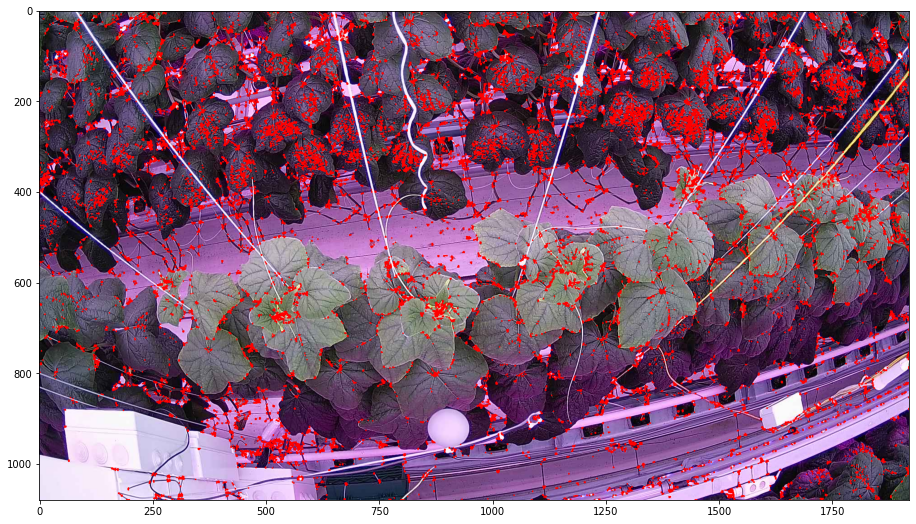

In [236]:
plt.figure(figsize = (18,9))
plt.imshow(head_is)

In [237]:
now_is=img[400:900, :]

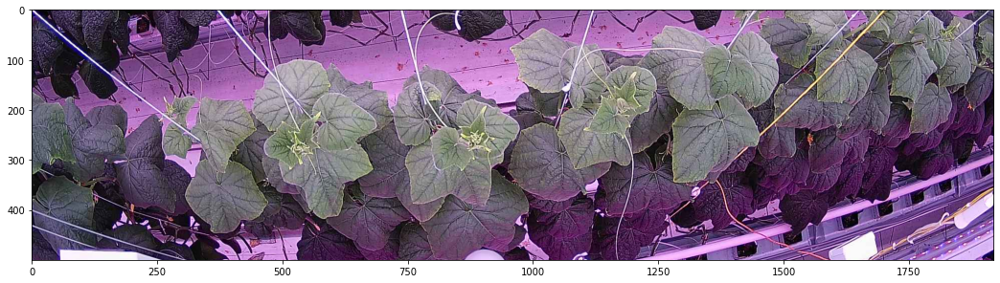

In [238]:
plt.figure(figsize = (18,9))
plt.imshow(now_is)

In [239]:
gray_cuc=cv2.cvtColor(now_is, cv2.COLOR_BGR2GRAY)

In [240]:
corners=cv2.goodFeaturesToTrack(gray_cuc,255,0.01,10) # -1 ja visus len'kus

In [241]:
corners=np.int0(corners)

In [242]:
for i in corners:
    x,y=i.ravel()
    cv2.circle(now_is, (x,y), 3, (255,0,0), -1)

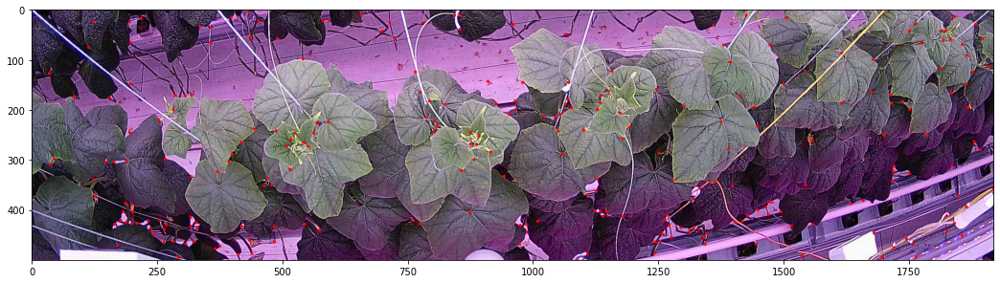

In [243]:
plt.figure(figsize = (18,9))
plt.imshow(now_is)

In [244]:
edges_is=img[400:900, :]

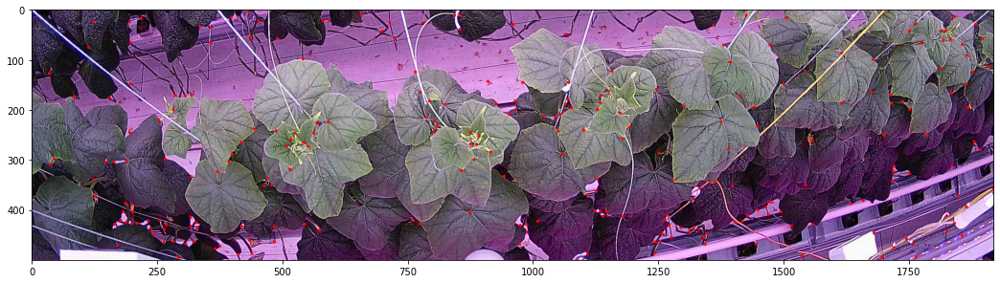

In [245]:
plt.figure(figsize = (18,9))
plt.imshow(edges_is)

In [257]:
form_is=img()
form_is=form_is[400:900, :]

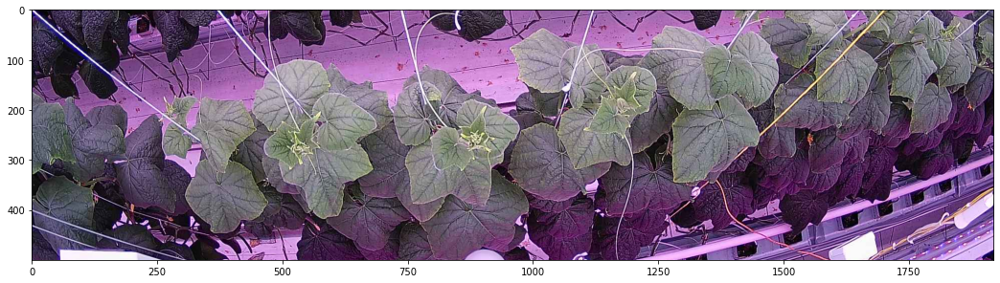

In [289]:
showimg(form_is)

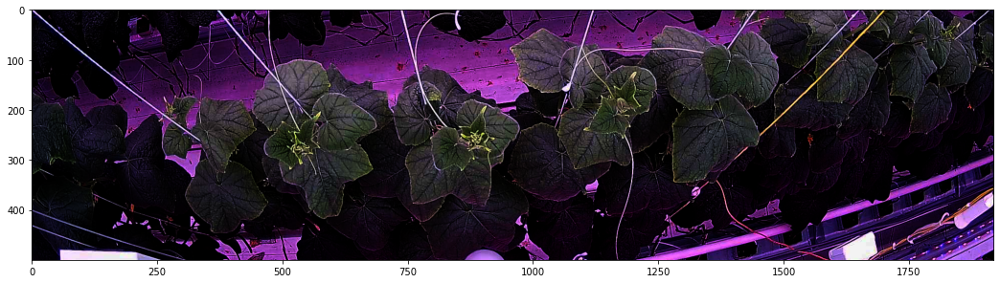

In [300]:
gamma=3
result=np.power(form_is,gamma)
showimg(result)

In [340]:
kernel=np.ones(shape=(3,3),dtype=np.float32)/3

In [341]:
dst=cv2.filter2D(result, -1, kernel)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


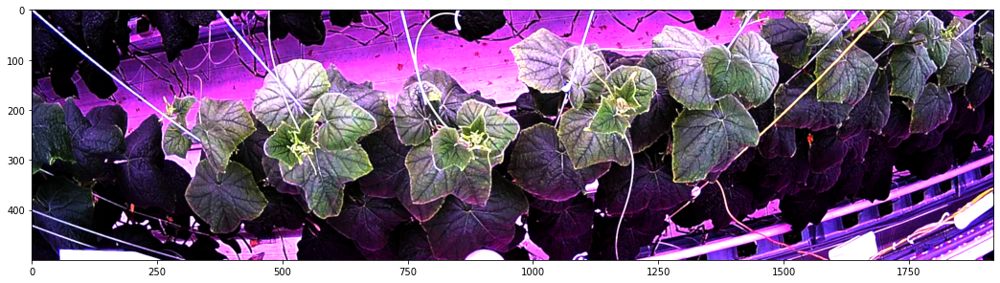

In [342]:
showimg(dst)

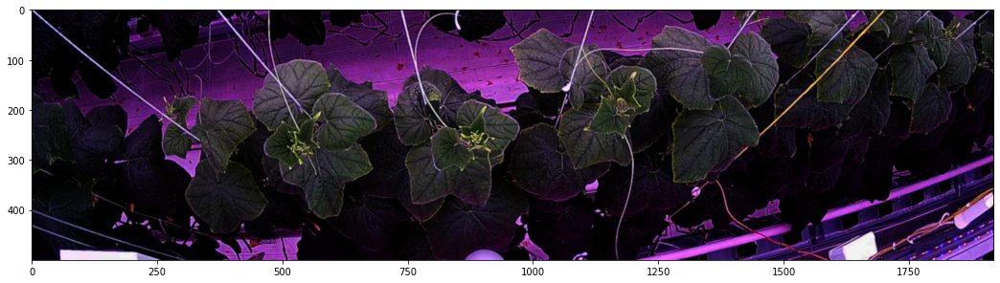

In [308]:
gausblur=cv2.GaussianBlur(result,(3,3),3)
showimg(gausblur)

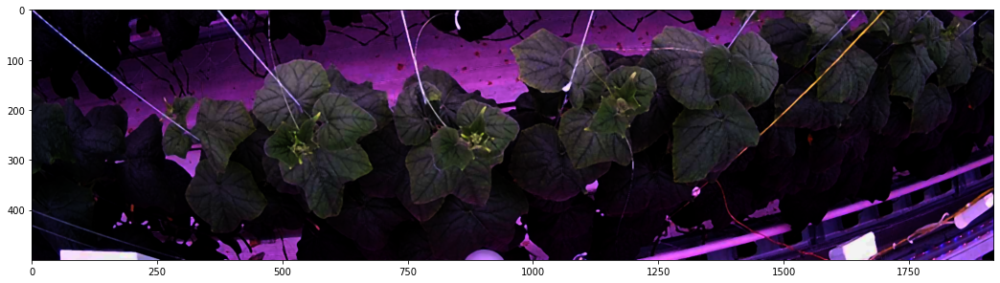

In [310]:
medblur=cv2.medianBlur(result,5)
showimg(medblur)

In [317]:
kern=np.ones(shape=(3,3),dtype=np.uint8)

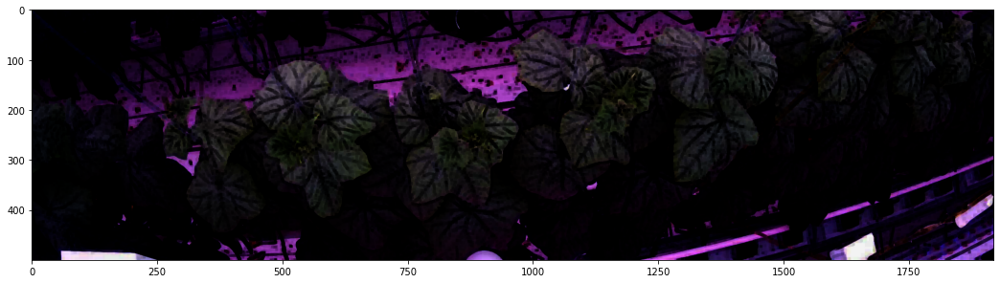

In [351]:
e_rod=cv2.erode(result,kern,iterations=2)
showimg(e_rod)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


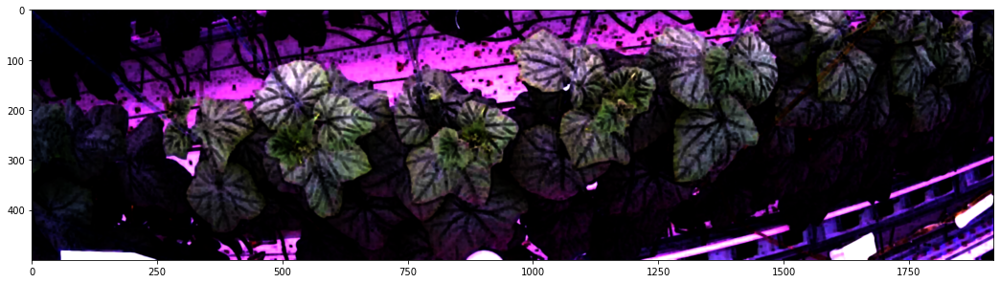

In [344]:
dst=cv2.filter2D(e_rod, -10, kernel)
showimg(dst)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


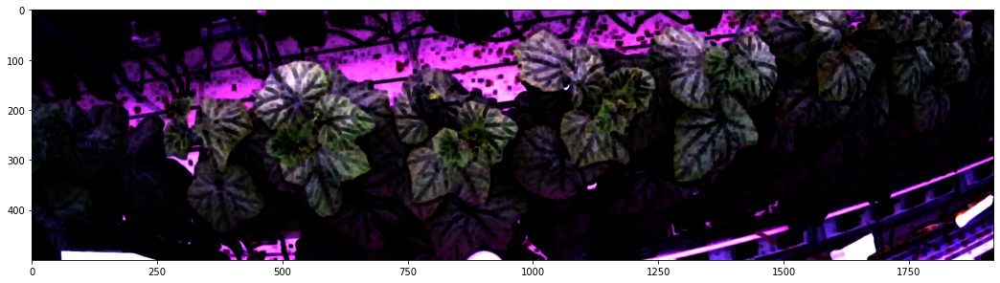

In [348]:
e_rod=cv2.erode(dst,kern,iterations=1)
showimg(e_rod)

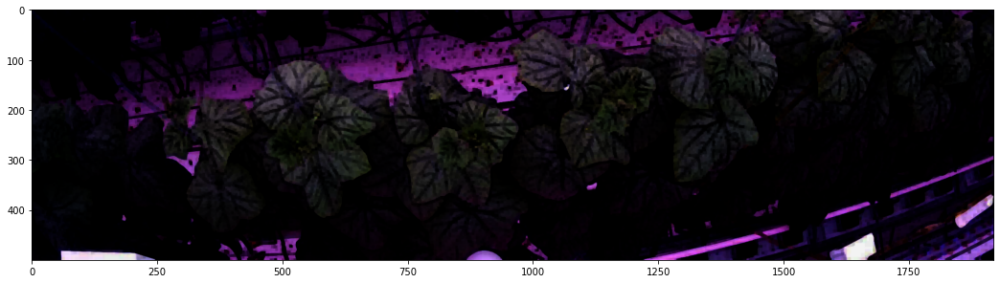

In [366]:
opening=cv2.morphologyEx(e_rod,cv2.MORPH_OPEN, kern)
showimg(opening)

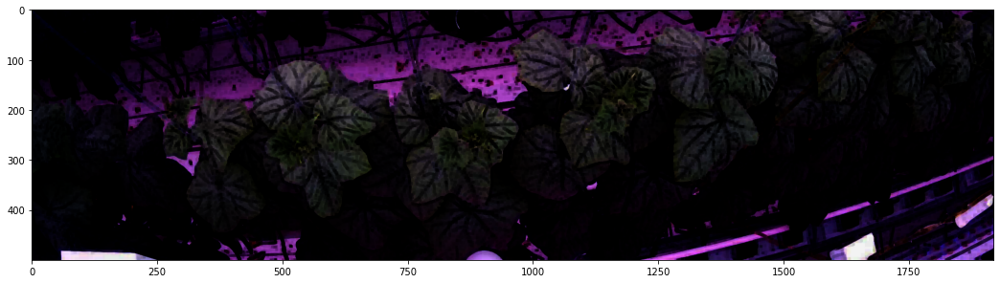

In [367]:
closing=cv2.morphologyEx(e_rod,cv2.MORPH_CLOSE, kern)
showimg(closing)

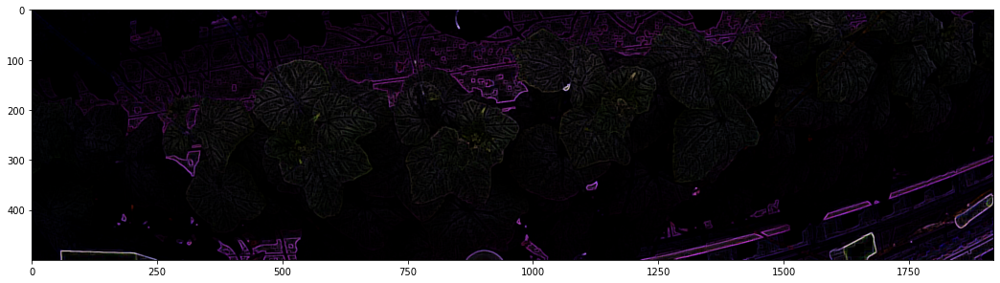

In [368]:
gradi=cv2.morphologyEx(closing,cv2.MORPH_GRADIENT, kern)
showimg(gradi)

In [369]:
zeko=['form_is','result','dst','gausblur','medblur','e_rod','opening','closing','gradi']

In [370]:
for name in zeko:
    sobelx=cv2.Sobel(name,cv2.CV_64F,1,0,ksize=5)
    showimg(sobelx)

error: OpenCV(4.5.3) :-1: error: (-5:Bad argument) in function 'Sobel'
> Overload resolution failed:
>  - src is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'src'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


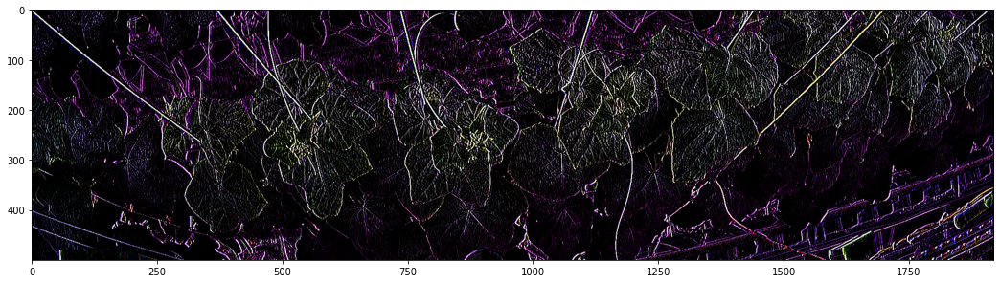

In [444]:
sobelx=cv2.Sobel(result,cv2.CV_64F,1,0,ksize=3)
showimg(sobelx)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


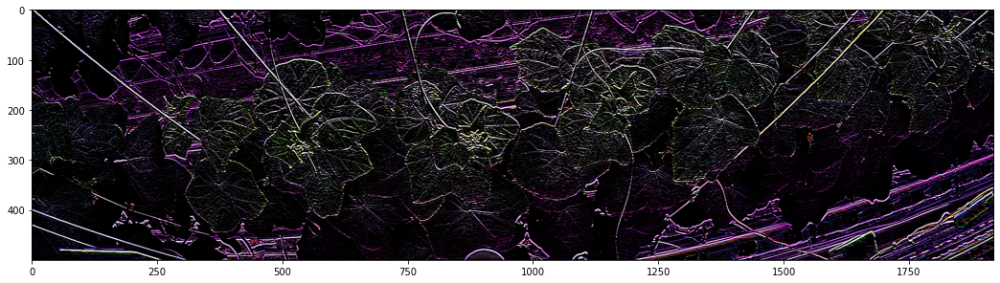

In [445]:
sobely=cv2.Sobel(result,cv2.CV_64F,0,1,ksize=3)
showimg(sobely)

In [446]:
deko=form_is.copy()

In [447]:
deko=cv2.addWeighted(src1=sobelx, alpha=0.5,src2=sobely, beta=0.5, gamma=0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


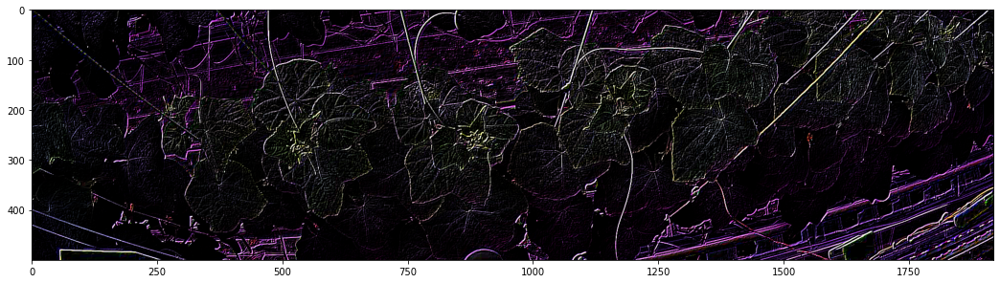

In [448]:
showimg(deko)

In [472]:
ret, th1=cv2.threshold(deko,0,150,cv2.THRESH_BINARY_INV)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


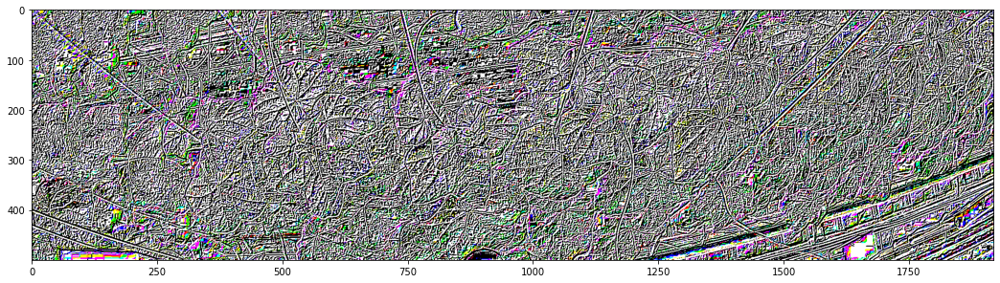

In [475]:
showimg(th1)

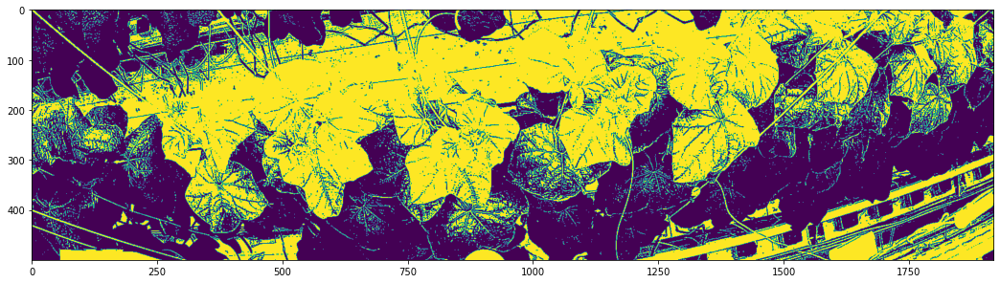

In [543]:
cun=cv2.imread('out.jpg',0)
hist=cun[400:900, :].copy()
hist_bw = cv.threshold(hist, 100, 200, cv.THRESH_BINARY)[1]
showimg(hist_bw)

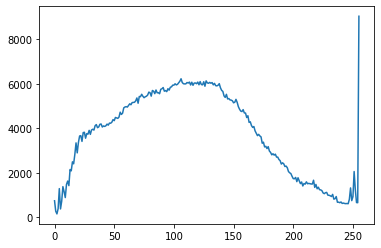

In [520]:
blucun=cv2.calcHist([hist],channels=[2],mask=None, histSize=[256], ranges=[0,256])
plt.plot(blucun)

Text(0.5, 1.0, 'Gurku histogramma')

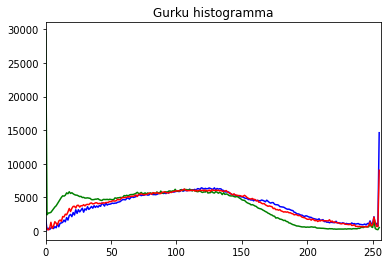

In [501]:
color=('b','g','r')

for i, col in enumerate(color):
    histr=cv2.calcHist([hist],[i],None,[256],[0,256])
    plt.plot(histr,color=col)
    plt.xlim([0,256])
plt.title('Gurku histogramma')

In [486]:
mask=np.zeros(hist.shape[:2], np.uint8)

In [490]:
gr_hist=cv2.calcHist([hist], channels=[1], mask=None,histSize=[256], ranges=[0,256])

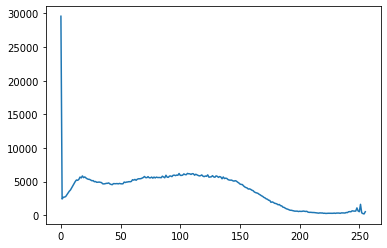

In [497]:
plt.plot(gr_hist);

In [498]:
eq_hist=cv2.equalizeHist(hist[1])


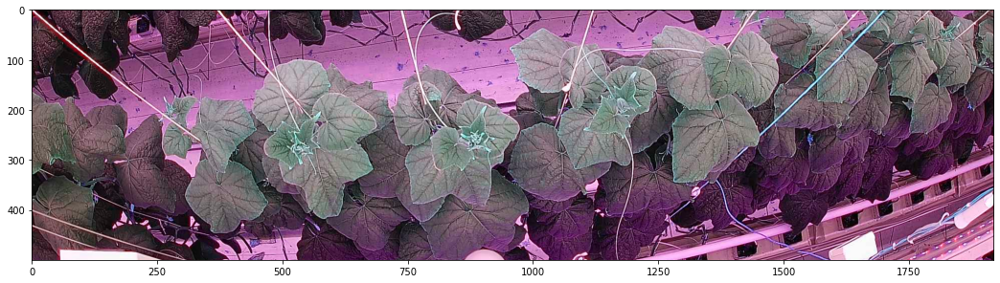

In [499]:
showimg(hist)

In [312]:
edges=cv2.Canny(image=edges_is, threshold1=240, threshold2=255)

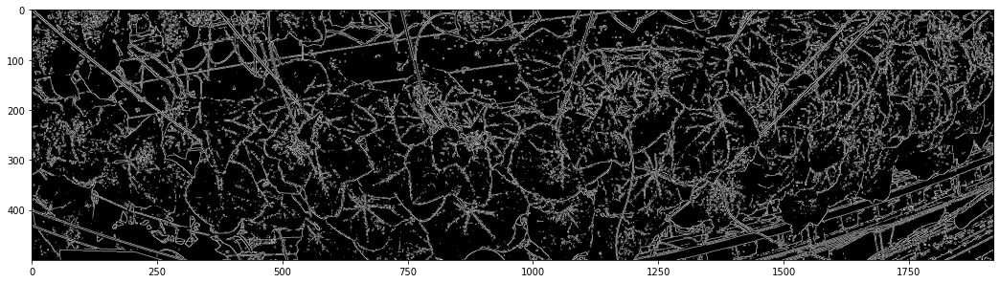

In [176]:
plt.figure(figsize = (18,9))
plt.imshow(edges, cmap='gray')

In [209]:
blur_edge=cv2.blur(edges_is, ksize=(4,4))

In [210]:
media=np.median(blur_edge)
lower=int(max(0,0.7*media))
upper=int(min(255,1.3,media))

In [211]:
bledges=cv2.Canny(image=blur_edge, threshold1=lower, threshold2=upper+100)

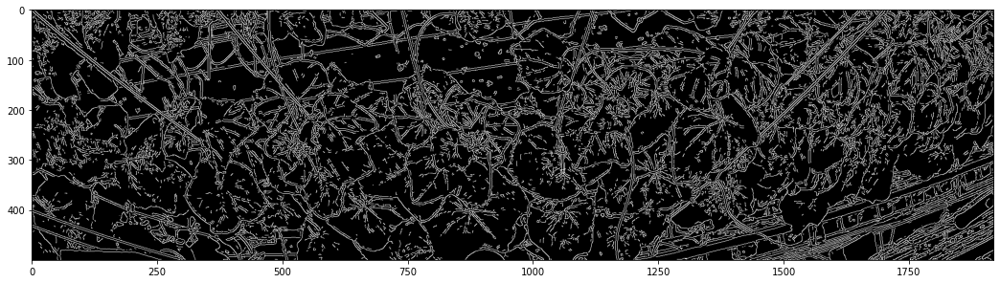

In [212]:
plt.figure(figsize = (18,9))
plt.imshow(bledges, cmap='gray')

In [171]:
zeheadz=bledges[210:320,500:580]

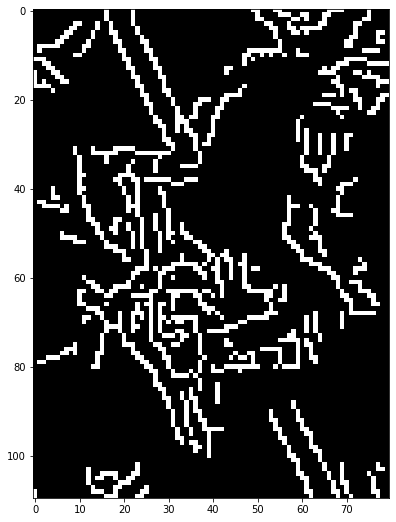

In [178]:
plt.figure(figsize = (18,9))
plt.imshow(zeheadz, cmap='gray')

In [180]:
thresh = cv2.threshold(bledges, 0, 255, cv2.THRESH_BINARY)[1]

In [201]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2,1))

In [202]:
morph = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

In [203]:
# find contours - write black over all small contours
letter = morph.copy()
cntrs = cv2.findContours(morph, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cntrs = cntrs[0] if len(cntrs) == 2 else cntrs[1]
for c in cntrs:
    area = cv2.contourArea(c)
    if area < 100:
        cv2.drawContours(letter,[c],0,(0,0,0),-1)

In [204]:
# do canny edge detection
edges = cv2.Canny(letter, 200, 200)

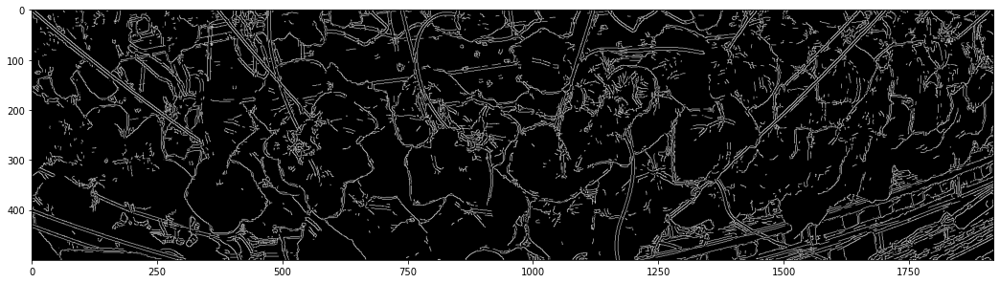

In [205]:
plt.figure(figsize = (18,9))
plt.imshow(thresh, cmap='gray')

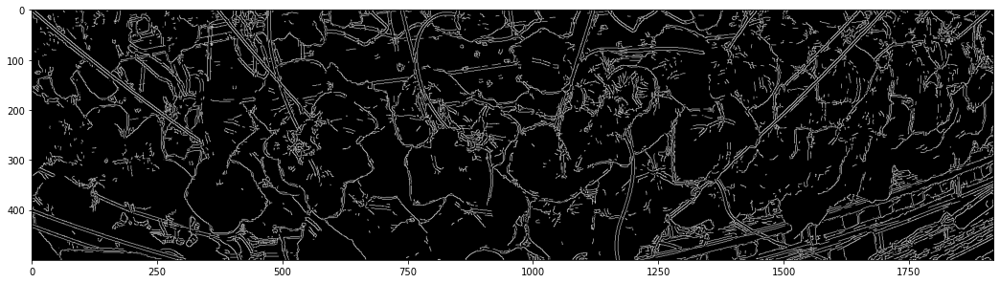

In [206]:
plt.figure(figsize = (18,9))
plt.imshow(morph, cmap='gray')

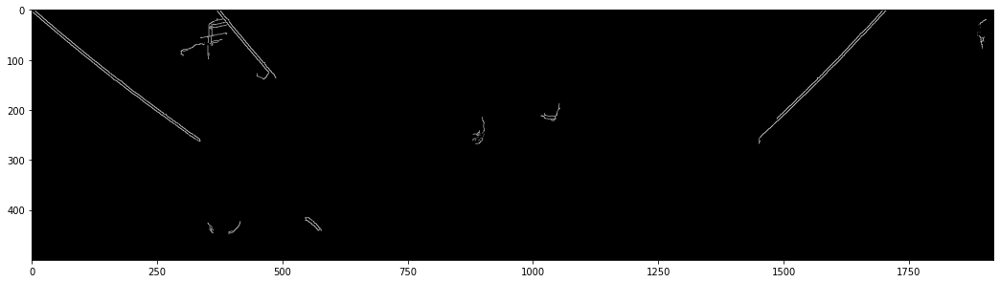

In [199]:
plt.figure(figsize = (18,9))
plt.imshow(letter, cmap='gray')

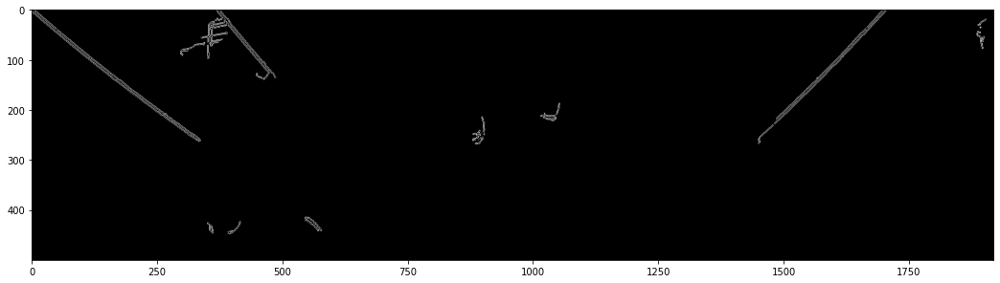

In [200]:
plt.figure(figsize = (18,9))
plt.imshow(edges, cmap='gray')

In [175]:
conto=img.copy()

In [12]:
def get_thermal_source(item):
    return item["type"] == "THERMAL_NUMPY"

thermal_source = list(filter(get_thermal_source, shot_source_response["sources"]))[0] 

display.Image(requests.get(thermal_source["url"]).content)

In [14]:
thermal_numpy=requests.get(thermal_source["url"]).content

In [24]:
thermal_numpy

b'\x93NUMPY\x01\x00v\x00{\'descr\': \'<f4\', \'fortran_order\': False, \'shape\': (120, 160), }                                                      \nO\x17\xd9Ap\xe6\xd7AA\x91\xd9A\xc8c\xd7Aw^\xd6A\x82\x12\xd4A1\r\xd3A1\r\xd3A\xe1\x07\xd2A\x89\x8a\xd2A<\xc1\xd0A\xe4C\xd1A\x85N\xd3Aw^\xd6A\'Y\xd5A{\x9a\xd5A\xcb\x9f\xd6A\'Y\xd5A\x82\x12\xd4A\x85N\xd3A*\x95\xd4AO\x17\xd9A\x19\xff\xdaA4\x0b\xdaA;\xce\xd9AA\x91\xd9Ac`\xd8A\\\x9d\xd8A-H\xdaA \xc2\xdaA\xd7`\xddA\xd0\x9d\xddA\xf1l\xdcAHT\xd9AA\x91\xd9Ai#\xd8A\xc8c\xd7A\xc8c\xd7Ap\xe6\xd7A{\x9a\xd5A\xe1\x07\xd2A,N\xcdA\xb4\x07\xcfA,N\xcdA,N\xcdA\xc7F\xcfA\xdeQ\xccAi\xd7\xcaA)\x82\xd0A\x90\x02\xd1A\x15C\xd0A\xc7F\xcfA1\r\xd3A\xd2\x17\xd5A{\x9a\xd5A~\xd6\xd4A\'Y\xd5A\xd6S\xd4A\x82\x12\xd4A\xcf\xdb\xd5A\xcf\xdb\xd5Ac`\xd8AHT\xd9A;\xce\xd9A-H\xdaAHT\xd9A\x0cy\xdbA\xeb\xa9\xdcA4\x0b\xdaA\x0cy\xdbA\'\x85\xdaA;\xce\xd9A\'\x85\xdaAA\x91\xd9Ac`\xd8Aw^\xd6A\x1f\xe1\xd6Aw^\xd6A\'Y\xd5A*\x95\xd4A\'Y\xd5A\'Y\xd5A\x1f\xe1\xd6A#\x1d\xd6Aw^\xd6A\\\x9d\xd8AU\x

In [17]:
import io
from PIL import Image
image = np.array(Image.open(io.BytesIO(thermal_numpy))) 
print('PIL:\n', image)

UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x000001E94F17A9A0>

We can also get the Stomata+ and Temperature+ images that came out of processing of this image, as well as the raw temperature readings. Along with the processed images, you also get the Stomata and Temperature values for Persisted Points.

In [25]:
shot_processed_response = requests.get("http://app.sigrow.com/api/v2/camera/{}/shot/{}/processed".format(
    selected_camera["id"], selected_shot["id"]
), headers={
    "X-API-Key": X_API_KEY
}).json()

pretty_print(shot_processed_response)


{
  "date": {
    "in_centrals_timezone": "2021-10-03T16:00:22+03:00",
    "in_gmt_timezone": "2021-10-03T13:00:22+00:00"
  },
  "processed": [
    {
      "url": "https://sigrow-thermal-development.ams3.digitaloceanspaces.com/processed/1019-c231b7aca02ec13c0e0e3ce279dab25f67674ebf9b1cc01c56f1b265/thermal/2021-10-03/i206x156/r12x54/1019-2021-10-03-13-00-22.png",
      "height": 156,
      "width": 206,
      "points": [
        {
          "y": 149,
          "x": 40,
          "id": 127,
          "value": 29.28
        },
        {
          "y": 55,
          "x": 14,
          "id": 139,
          "value": 28.13
        },
        {
          "y": 44,
          "x": 132,
          "id": 140,
          "value": 28.04
        }
      ],
      "size_bytes": 43611,
      "type": "THERMAL_PNG"
    },
    {
      "url": "https://sigrow-thermal-development.ams3.digitaloceanspaces.com/processed/1019-c231b7aca02ec13c0e0e3ce279dab25f67674ebf9b1cc01c56f1b265/thermal/2021-10-03/i640x480/r40x16

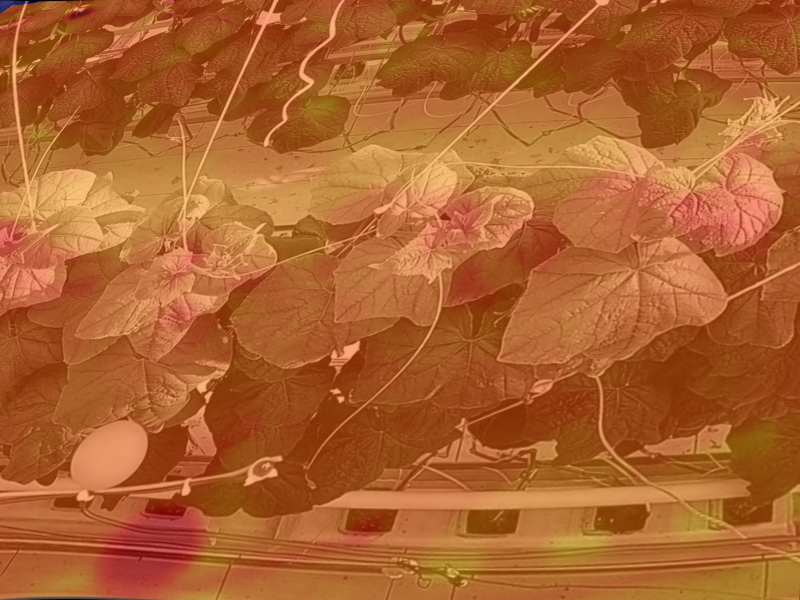

In [30]:
def get_low_res(item):
    return item["height"] == 156 and item["width"] == 206

def get_high_res(item):
    return item["height"] == 600 and item["width"] == 800

def get_temperature_plus_low_res_processed(item):
    return get_low_res(item) and item["type"] == "THERMAL_PLUS_PNG"

def get_temperature_plus_high_res_processed(item):
    return get_high_res(item) and item["type"] == "THERMAL_PLUS_PNG"


thermal_plus_low_res = list(filter(get_temperature_plus_high_res_processed, shot_processed_response["processed"]))[0] 

display.Image(requests.get(thermal_plus_low_res["url"]).content)


So to see eg. the stomata value of Persisted Point ID 2 in this image, you can do the following:

In [27]:
thermal_png=requests.get(thermal_plus_high_res["url"]).content

In [28]:
thermal_png

b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x03 \x00\x00\x02X\x08\x02\x00\x00\x00\x15\x14\x15\'\x00\x00\t\xa2iTXtXML:com.adobe.xmp\x00\x00\x00\x00\x00<?xpacket begin="\xef\xbb\xbf" id="W5M0MpCehiHzreSzNTczkc9d"?>\n<x:xmpmeta xmlns:x="adobe:ns:meta/" x:xmptk="XMP Core 4.4.0-Exiv2">\n <rdf:RDF xmlns:rdf="http://www.w3.org/1999/02/22-rdf-syntax-ns#">\n  <rdf:Description rdf:about=""\n    xmlns:sigrow="https://sigrow.com/"\n   sigrow:max_value="35.083744"\n   sigrow:min_value="25.063732"\n   sigrow:color_map="jet"/>\n </rdf:RDF>\n</x:xmpmeta>\n                                                                                                    \n                                                                                                    \n                                                                                                    \n                                                                                                    \n                                            

In [32]:
def get_temperature_json_low_res(item):
    return get_low_res(item) and item["type"] == "THERMAL_JSON"

In [33]:
temperature_json_data = list(filter(get_temperature_json_low_res, shot_processed_response["processed"]))[0] 
# temperature_json_persisted_point_2 = list(filter(get_point_id_2, temperature_json_data["points"]))[0] 

IndexError: list index out of range

In [35]:
x = 40
y = 144

thermal_array = requests.get(temperature_json_data["url"]).json()

print("Thermal value at X:{}, Y:{}: {}".format(x, y, thermal_array[y][x])) # remember that vertical (y) index comes first!

Thermal value at X:40, Y:144: 27.6


In [31]:
# def get_stomata_json_low_res(item):
#     return get_low_res(item) and item["type"] == "STOMATA_JSON"

def get_temperature_json_low_res(item):
    return get_low_res(item) and item["type"] == "THERMAL_JSON"

def get_point_id_2(item):
    return item["id"] == 2

stomata_json_data = list(filter(get_stomata_json_low_res, shot_processed_response["processed"]))[0] 
stomata_json_persisted_point_2 = list(filter(get_point_id_2, stomata_json_data["points"]))[0] 

temperature_json_data = list(filter(get_temperature_json_low_res, shot_processed_response["processed"]))[0] 
temperature_json_persisted_point_2 = list(filter(get_point_id_2, temperature_json_data["points"]))[0] 

print("Persisted Point ID 2 set at X:{}, Y:{}".format(stomata_json_persisted_point_2["x"], stomata_json_persisted_point_2["y"]))

print("Persisted Point ID 2 stomata value: {}".format(stomata_json_persisted_point_2["value"]))
print("Persisted Point ID 2 temperature value: {}".format(temperature_json_persisted_point_2["value"]))

IndexError: list index out of range

You can also get a corrected stomata (and temperature) value for any pixel point on the image, say, (90, 90):

In [12]:
x = 90
y = 90

stomata_array = requests.get(stomata_json_data["url"]).json()

print("Stomata value at X:{}, Y:{}: {}".format(x, y, stomata_array[y][x])) # remember that vertical (y) index comes first!

Stomata value at X:90, Y:90: 0.1


In [37]:
import cv2 as cv

In [39]:
img=cv.imread(requests.get(thermal_plus_low_res["url"]).content,1)

TypeError: Can't convert object of type 'bytes' to 'str' for 'filename'